In [1]:
include("ViscousStreaming.jl")

Main.ViscousStreaming

In [2]:
using ImmersedLayers
using DifferentialEquations
using Plots
using UnPack

In [3]:
β = 0.95
τ = 0.1

0.1

# get exact solutions

In [4]:
Δx = 0.02
Lx = 8.0
xlim = (-Lx/2,Lx/2)
ylim = (-Lx/2,Lx/2)
g = PhysicalGrid(xlim,ylim,Δx)
RadC = 1.0
Δs = 1.4*cellsize(g)
body = Circle(RadC,Δs)
cache1 = SurfaceVectorCache(body,g,scaling=GridScaling,dtype=ComplexF64) # first-order solution
cache2 = SurfaceVectorCache(body,g,scaling=GridScaling) # second-order solution

Surface cache with scaling of type GridScaling
  224 point data of type VectorData{224, Float64, Vector{Float64}}
  Grid data of type Edges{Primal, 405, 405, Float64, Vector{Float64}}


In [5]:
Re = 40
ϵ = 0.1
p = ViscousStreaming.StreamingParams(ϵ,Re)
s = ViscousStreaming.StreamingAnalytical(p)

Maximum residual on W₁ = 5.684341886080802e-14
BC residual on Ψ₁(1) = 1.1443916996305594e-16
BC residual on dΨ₁(1) = 2.2887833992611187e-16
Maximum residual on Ws₂ = 3.979039320256561e-13
BC residual on Ψs₂(1) = 3.552713678800501e-15
BC residual on dΨs₂(1) = 2.6645352591003757e-15
Maximum residual on W₂ = 1.67181510390182e-12
BC residual on Ψ₂(1) = 2.8609792490763984e-17
BC residual on dΨ₂(1) = 2.220446049250313e-15


Analytical streaming flow solution for
single cylinder with Re = 40.0, ϵ = 0.1


In [6]:
u1 = zeros_grid(cache1)
u2 = zeros_grid(cache2)
ω1 = zeros_gridcurl(cache1);

In [7]:
u1_u = similar(u1.u); # this is u1 hat
u1_v = similar(u1.v); # this is v1 hat
u2_u = similar(u2.u); # this is mean u2
u2_v = similar(u2.v); # this is mean v2
t = 0.0;

In [8]:
u_grid_x = cache2.xg.u[:,1]
u_grid_y = cache2.yg.u[1,:]
v_grid_x = cache2.xg.v[:,1]
v_grid_y = cache2.yg.v[1,:]
ω_grid_x = x_gridcurl(cache2)[:,1];
ω_grid_y = y_gridcurl(cache2)[1,:];

In [9]:
for j in 1:length(u_grid_y)
    for i in 1:length(u_grid_x)
        u1_u[i, j] = ViscousStreaming.uvelocity(u_grid_x[i], u_grid_y[j], t, s.s1)
        u2_u[i, j] = ViscousStreaming.uvelocity(u_grid_x[i], u_grid_y[j], t, s.s2)
    end
end

In [10]:
for j in 1:length(v_grid_y)
    for i in 1:length(v_grid_x)
        u1_v[i, j] = ViscousStreaming.vvelocity(v_grid_x[i], v_grid_y[j], t, s.s1)
        u2_v[i, j] = ViscousStreaming.vvelocity(v_grid_x[i], v_grid_y[j], t, s.s2)
    end
end

In [11]:
for j in 1:length(ω_grid_y)
    for i in 1:length(ω_grid_x)
        ω1[i, j] = ViscousStreaming.vorticity(ω_grid_x[i], ω_grid_y[j], t, s.s1)
    end
end

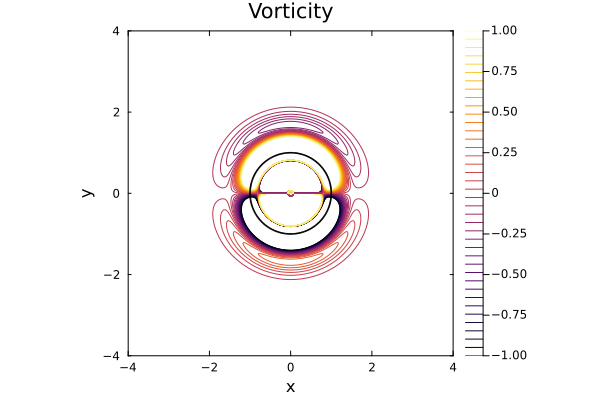

In [12]:
plot(real(ω1), cache1, levels = range(-1, 1, 40), clims = (-1, 1), aspect_ratio = 1, xlims = (-4, 4), ylims = (-4, 4), xlabel = "x", ylabel = "y", title = "Vorticity", colorbar = true)

In [13]:
u1.u .= u1_u
u1.v .= u1_v
u2.u .= u2_u
u2.v .= u2_v;


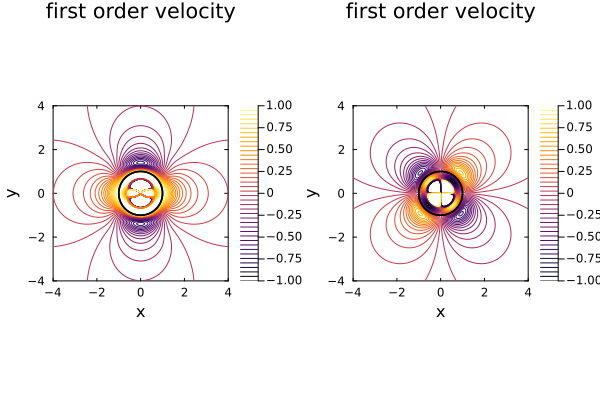

In [14]:
plot(real(u1), cache1, levels = range(-1, 1, 40), clims = (-1, 1), aspect_ratio = 1, xlims = (-4, 4), ylims = (-4, 4), xlabel = "x", ylabel = "y", title = "first order velocity", colorbar = true)

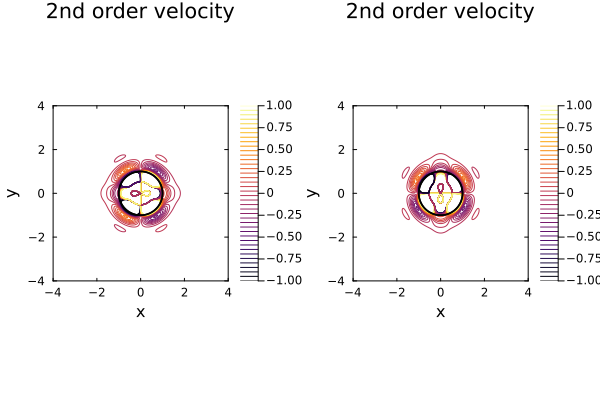

In [15]:
plot(u2, cache2, levels = range(-1, 1, 40), clims = (-1, 1), aspect_ratio = 1, xlims = (-4, 4), ylims = (-4, 4), xlabel = "x", ylabel = "y", title = "2nd order velocity", colorbar = true)

# Calculate Lagrangian mean fluid velocity field

## a1

In [16]:
lu1 = zeros_grid(cache1)
laplacian!(lu1, u1, cache1)
a1 = im * (β-1) * u1 + 0.5 * β / Re * lu1;

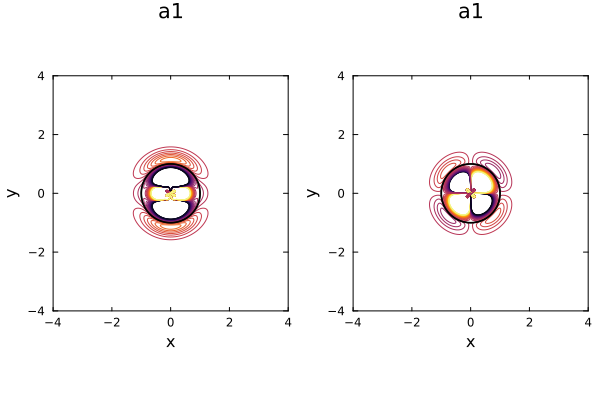

In [17]:
plot(real(a1), cache1, levels = range(-1, 1, 40), clims = (-1, 1), aspect_ratio = 1, xlims = (-4, 4), ylims = (-4, 4), xlabel = "x", ylabel = "y", title = "a1")

## v1

In [18]:
v1 = u1 + τ * a1;

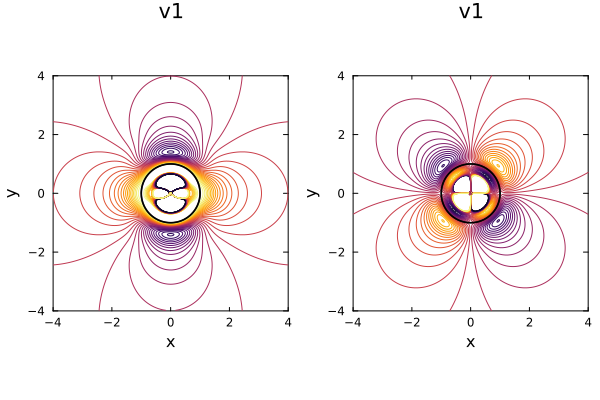

In [19]:
plot(real(v1), cache1, levels = range(-1, 1, 40), clims = (-1, 1), aspect_ratio = 1, xlims = (-4, 4), ylims = (-4, 4), xlabel = "x", ylabel = "y", title = "v1")

## mean fluid acceleration force a2

In [20]:
udu = zeros_grid(cache1);

In [21]:
cdcache = ConvectiveDerivativeCache(cache1);

In [22]:
# v.∇u, where v and u are both primal edge data
function _unscaled_convective_derivative!(vdu::Edges{Primal},v::Edges{Primal},u::Edges{Primal},extra_cache::ConvectiveDerivativeCache)
    @unpack vt1_cache, vt2_cache, vt3_cache = extra_cache

    fill!(vt1_cache,0.0)
    grid_interpolate!(vt1_cache,v)
    CartesianGrids.transpose!(vt2_cache,vt1_cache)
    fill!(vt1_cache,0.0)
    grad!(vt1_cache,u)
    product!(vt3_cache,vt2_cache,vt1_cache)
    fill!(vdu,0.0)
    grid_interpolate!(vdu,vt3_cache)
end

_unscaled_convective_derivative! (generic function with 1 method)

In [23]:
_unscaled_convective_derivative!(udu, u1, conj(u1), cdcache)
ImmersedLayers._scale_derivative!(udu, cache1)
lu2 = zeros_grid(cache2)
laplacian!(lu2, u2, cache2)
a2 = 0.5 * (β-1) * real(udu) + 0.5 * β / Re * lu2;

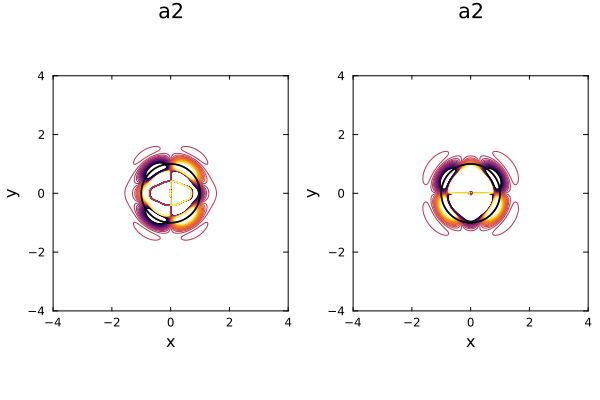

In [24]:
plot(a2, cache2, levels = range(-1, 1, 40), clims = (-1, 1), aspect_ratio = 1, xlims = (-4, 4), ylims = (-4, 4), xlabel = "x", ylabel = "y", title = "a2")

## saffman term

In [25]:
Ls0, Ls2 = ViscousStreaming.saffman(a1, ω1)

(Primal edges for a (nx = 405, ny = 405) cell grid of type ComplexF64 data
  Internal u-faces: (nx = 405, ny = 404)
  Internal v-faces: (nx = 404, ny = 405), Primal edges for a (nx = 405, ny = 405) cell grid of type ComplexF64 data
  Internal u-faces: (nx = 405, ny = 404)
  Internal v-faces: (nx = 404, ny = 405))

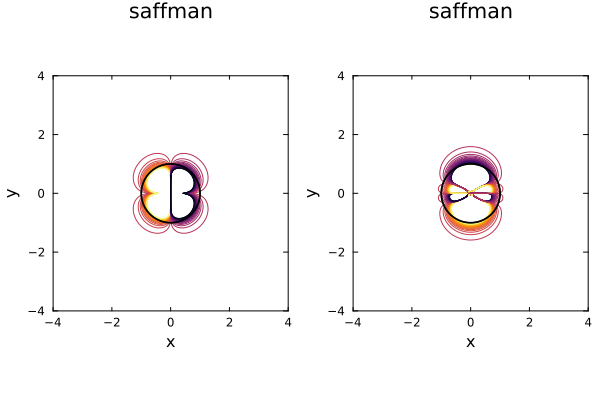

In [26]:
plot(real(Ls0), cache1, levels = range(-1, 1, 40), clims = (-1, 1), aspect_ratio = 1, xlims = (-4, 4), ylims = (-4, 4), xlabel = "x", ylabel = "y", title = "saffman")

## v2

In [27]:
v2 = u2 + τ * a2 - sqrt(τ^3*β/ϵ) * real(Ls0);

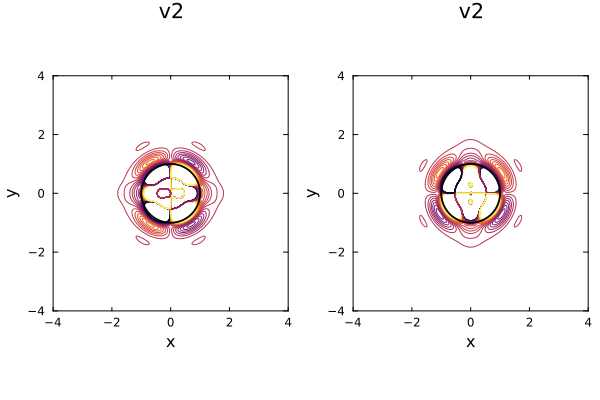

In [28]:
plot(v2, cache2, levels = range(-1, 1, 40), clims = (-1, 1), aspect_ratio = 1, xlims = (-4, 4), ylims = (-4, 4), xlabel = "x", ylabel = "y", title = "v2")

## v_drift

In [29]:
vdv = zeros_grid(cache1)
_unscaled_convective_derivative!(vdv, v1, conj(v1), cdcache)
ImmersedLayers._scale_derivative!(vdv, cache1)
v_drift =  1/2 * imag(vdv); 

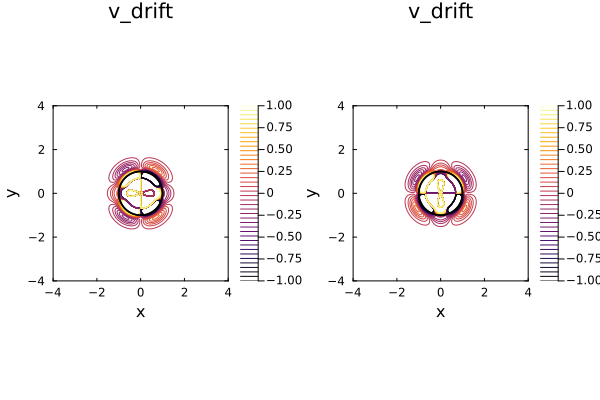

In [30]:
plot(v_drift, cache2, levels = range(-1, 1, 40), clims = (-1, 1), aspect_ratio = 1, xlims = (-4, 4), ylims = (-4, 4), xlabel = "x", ylabel = "y", title = "v_drift", colorbar = true)

## v_L

In [31]:
v_L = ϵ^2 * (v2 + v_drift);

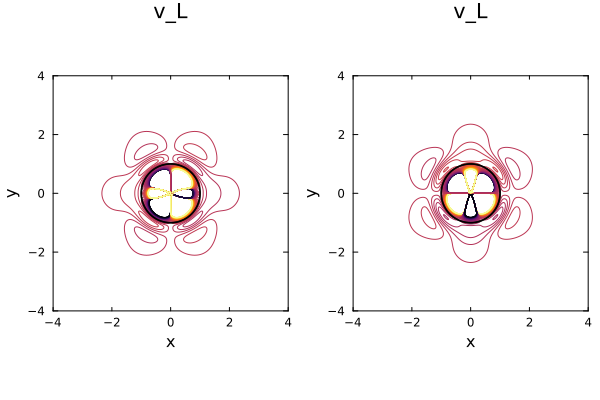

In [32]:
plot(v_L, cache2, levels = range(-0.01, 0.01, 100), clims = (-0.01, 0.01), aspect_ratio = 1, xlims = (-4, 4), ylims = (-4, 4), xlabel = "x", ylabel = "y", title = "v_L")

# Propogate particle

In [33]:
v_L_u_interp = interpolatable_field(v_L.u, g)
v_L_v_interp = interpolatable_field(v_L.v, g);

In [34]:
function particle_dynamics!(du, u, p, t)
    x, y = u
    du[1] = v_L_u_interp(x, y)  # dx/dt = u(x, y)
    du[2] = v_L_v_interp(x, y)  # dy/dt = v(x, y)
end

particle_dynamics! (generic function with 1 method)

In [44]:
x0, y0 = 2.0, 3.0  # starting position
u0 = [x0, y0]
tspan = (0.0, 10 * 25000.0)  # from t=0 to t=10

(0.0, 250000.0)

In [45]:
prob = ODEProblem(particle_dynamics!, u0, tspan)
sol = DifferentialEquations.solve(prob, saveat=10);

In [ ]:
x_traj = sol[1, :]
y_traj = sol[2, :]

plot(x_traj, y_traj, aspect_ratio = 1, xlims = (0, 4), ylims = (0, 4), xlabel = "x", ylabel = "y", title = "Particle Trajectory (Numerical)")
θ = range(0, 2π, length=200)
circle_x = cos.(θ)
circle_y = sin.(θ)
plot!(circle_x, circle_y, fill = (0, :grey), label = "Cylinder", legend = false)

# savefig("particle_trajectory.pdf")

"/Users/wuqiyuan/julia/Viscous-Streaming/particle_trajectory.pdf"